[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/MokryYezhik/studying-CNN/blob/master/%5Bhw%5Dgan_final.ipynb)

<p style="align: center;"><img align=center src="https://s8.hostingkartinok.com/uploads/images/2018/08/308b49fcfbc619d629fe4604bceb67ac.jpg" width=500 height=450/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Generative adversarial networks</b></h3>



В этом домашнем задании вы обучите GAN генерировать лица людей и посмотрите на то, как можно оценивать качество генерации

In [ ]:
import os
import random
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
from torch.nn import functional as F
from torchvision import models
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

In [ ]:
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    random.seed(seed)
    #os.environ['PYTHONHASHSEED'] = str(seed)

set_seed(42)

In [ ]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'DEVICE: {DEVICE}')

DEVICE: cpu


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [ ]:
PATH = '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/'

def save_model(model, model_name, optimizer, loss=None, score=None):
    if loss:
        torch.save({'discrimanator_state_dict': model["discriminator"].state_dict(),
                    'generator_state_dict': model["generator"].state_dict(),
                    'optim_disc_state_dict': optimizer["discriminator"].state_dict(),
                    'optim_gen_state_dict': optimizer["generator"].state_dict(),
                    'loss': loss,
                    'score': score},
                   PATH + model_name + '.tar')
    else:
        torch.save(model.state_dict(), PATH + model_name + '.pth')

def load_model(model, model_name, optimizer, need_loss=True):
    if need_loss:
        checkpoint = torch.load(PATH + model_name + '.tar', map_location=torch.device(DEVICE))
        model["discriminator"].load_state_dict(checkpoint['discrimanator_state_dict'])
        model["generator"].load_state_dict(checkpoint['generator_state_dict'])
        optimizer["discriminator"].load_state_dict(checkpoint['optim_disc_state_dict'])
        optimizer["generator"].load_state_dict(checkpoint['optim_gen_state_dict'])
        loss = checkpoint['loss']
        score = checkpoint['score']
        return loss, score
    else:
        model.load_state_dict(torch.load(PATH + model_name + '.pth', map_location=torch.device(DEVICE)))

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [ ]:
# custom weights initialization with mean=0, std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
def denorm(img_tensors):
    return img_tensors * STATS[1][0] + STATS[0][0]

In [ ]:
!pip install gdown

## Часть 1. Подготовка данных (1 балл)

В качестве обучающей выборки возьмем часть датасета [Flickr Faces](https://github.com/NVlabs/ffhq-dataset), который содержит изображения лиц людей в высоком разрешении (1024х1024). Оригинальный датасет очень большой, поэтому мы возьмем его часть. Скачать датасет можно [здесь](https://drive.google.com/file/d/1KWPc4Pa7u2TWekUvNu9rTSO0U2eOlZA9/view?usp=sharing)

Давайте загрузим наши изображения. Напишите функцию, которая строит DataLoader для изображений, при этом меняя их размер до нужного значения (размер 1024 слишком большой, поэтому мы рекомендуем взять размер 128 либо немного больше)

In [ ]:
import gdown

# zip with images thumbnails 128x128

url = 'https://drive.google.com/uc?id=1OYGspoli1Du580inMpyJgGnVmfGundp1'
output = 'ffhq.zip'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1OYGspoli1Du580inMpyJgGnVmfGundp1
To: /content/ffhq.zip
100%|██████████| 2.11G/2.11G [00:21<00:00, 96.7MB/s]


'ffhq.zip'

In [ ]:
!unzip /content/ffhq.zip

In [ ]:
class MyDataset(Dataset):
    def __init__(self, root, n_samples, transform=None):
        self.root = root
        self.transform = transform

        for _, _, files in os.walk(self.root):
            all_files = np.sort(np.array(files))

        set_seed(42)
        
        if n_samples != len(all_files):
            file_idx = np.random.randint(low=0, high=len(all_files),
                          size=(n_samples,))
            self.files = all_files[file_idx]
        else:
            self.files = all_files
        
    def __getitem__(self, index):
        image_path = os.path.join(self.root, self.files[index])
        x = Image.open(image_path) # PIL
        if self.transform is not None:
            x = self.transform(x) # tensor
        return x
    
    def __len__(self):
        return len(self.files)

In [ ]:
STATS = ((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))

def get_dataloader(image_size, batch_size, n_samples):
    """
    Builds dataloader for training data.
    Use tt.Compose and tt.Resize for transformations
    :param image_size: height and wdith of the image
    :param batch_size: batch_size of the dataloader
    :returns: DataLoader object 
    """
    # TODO: resize images, convert them to tensors and build dataloader

    ds = MyDataset(root='/content/ffhq',
                    n_samples=n_samples,
                    transform=tt.Compose([
                                  tt.ToTensor(),
                                  tt.Normalize(*STATS)]))

    return DataLoader(ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

In [ ]:
IMAGE_SIZE = 128
BATCH_SIZE = 64
LATENT_SIZE = 128

#TODO: build dataloader and transfer it to device
train_dl = get_dataloader(image_size=IMAGE_SIZE, batch_size=BATCH_SIZE, n_samples=30000)

In [ ]:
set_seed(42)
fixed_latent = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1, device=DEVICE)

## Часть 2. Построение и обучение модели (2 балла)

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

Некоторые советы по обученю GAN'ов:

[https://github.com/soumith/ganhacks]

[https://machinelearningmastery.com/how-to-code-generative-adversarial-network-hacks/]


Использовалось:
- Нормальный шум в дискриминатор (очень хорошо улучшает генерируемые изображения): https://www.reddit.com/r/deeplearning/comments/oigdgg/adding_guassian_noise_to_discriminator_layers_in/ 
- Дропаут в генератор
- Soft labels
- Флип лейблов
- Буффер 

In [ ]:
class GausianNoise(nn.Module):
    def __init__(self, std=0.1):
        super().__init__()
        self.std = std

    def forward(self, x):
        if self.training:
            return x + torch.empty_like(x).normal_(mean=0., std=0.1)
        else:
            return x

In [ ]:
discriminator = nn.Sequential(
    # 3 x 128 x 128
    GausianNoise(std=0.1),
    nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.LeakyReLU(0.2, inplace=True),
    # 64 x 64 x 64
    GausianNoise(std=0.1),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # 128 x 32 x 32
    GausianNoise(std=0.1),
    nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # 256 x 16 x 16
    GausianNoise(std=0.1),
    nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # 512 x 8 x 8
    GausianNoise(std=0.1),
    nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(1024),
    nn.LeakyReLU(0.2, inplace=True),
    # 1024 x 4 x 4
    nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
    # 1 x 1 x 1
    nn.Sigmoid(),
    nn.Flatten()
    # 1
)

In [ ]:
LATENT_SIZE = 128 # choose latent size

generator = nn.Sequential(
    # 128 x 1 x 1
    nn.ConvTranspose2d(in_channels=LATENT_SIZE, out_channels=1024, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(1024),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 1024 x 4 x 4
    nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 512 x 8 x 8
    nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 256 x 16 x 16
    nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 128 x 32 x 32
    nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 64 x 64 x 64
    nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.Dropout(0.1),
    nn.ReLU(inplace=True),
    # 32 x 128 x 128
    nn.ConvTranspose2d(in_channels=32, out_channels=3, kernel_size=1, stride=1, padding=0, bias=False),
    # 3 x 128 x 128
    nn.Tanh()
)

In [ ]:
lr_g = 0.0002
lr_d = 0.0001

model = {
    "discriminator": discriminator.to(DEVICE),
    "generator": generator.to(DEVICE)
}

model["discriminator"].apply(weights_init)
model["generator"].apply(weights_init)

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}

optimizer = {
    "discriminator": torch.optim.Adam(model["discriminator"].parameters(), 
                                      lr=lr_d, betas=(0.5, 0.999)),
    "generator": torch.optim.Adam(model["generator"].parameters(),
                                  lr=lr_g, betas=(0.5, 0.999))
}

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [ ]:
def train_model(model, dataloader, criterion, optimizer, epochs, model_name=None):
    # TODO: build optimizers and train your GAN
    model["discriminator"].train()
    model["generator"].train()
    torch.cuda.empty_cache()
    
    # Losses & scores
    img_list = []
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    # initialize buffer
    latent = torch.randn((BATCH_SIZE, LATENT_SIZE, 1, 1), device=DEVICE)
    fake_images = model["generator"](latent) # B x W x H
    buffer = fake_images.clone() # B x W x H

    
    for epoch in range(epochs):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []

        model["generator"].train()

        for real_images in tqdm(dataloader):
            real_images = real_images.to(DEVICE)
            b_size = real_images.size(0)
            flip_size = int(np.ceil(b_size*0.1))

            # DISCRIMINATOR
            model["discriminator"].zero_grad()

            # Pass real images through discriminator
            real_preds = model["discriminator"](real_images)
            real_targets = torch.ones((b_size, 1), device=DEVICE)
            real_targets = torch.ones((b_size, 1), device=DEVICE) \
                            - 0.1 * torch.rand((b_size, 1), device=DEVICE)
            # flip
            flip_idx = torch.randint(low=0, high=b_size-1, size=(flip_size,),
                                     device=DEVICE)
            real_targets[flip_idx] = torch.zeros((flip_size, 1), device=DEVICE) \
                            + 0.1 * torch.rand((flip_size, 1), device=DEVICE)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()

            # generate fake images
            latent = torch.randn((b_size, LATENT_SIZE, 1, 1), device=DEVICE)
            fake_images = model["generator"](latent) # B x W x H

            fake_images_with_buffer = fake_images.clone()

            # BUFFER
            rand_ind_batch = torch.randperm(b_size)[:b_size//2] # индексы
            fake_images_with_buffer[rand_ind_batch] = buffer[rand_ind_batch].detach()
            buffer[rand_ind_batch] = fake_images[rand_ind_batch]

            # pass fake images through discrimanator
            fake_targets = torch.zeros((b_size, 1), device=DEVICE) \
                            + 0.1 * torch.rand((b_size, 1), device=DEVICE)
            # flip
            flip_idx = torch.randint(low=0, high=b_size-1, size=(flip_size,),
                                     device=DEVICE)
            fake_targets[flip_idx] = torch.ones((flip_size, 1), device=DEVICE) \
                            - 0.1 * torch.rand((flip_size, 1), device=DEVICE)
            fake_preds = model["discriminator"](fake_images_with_buffer)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())
            
            
            # GENERATOR
            model["generator"].zero_grad()

            # generate fake images
            latent = torch.randn((b_size, LATENT_SIZE, 1, 1), device=DEVICE)
            fake_images = model["generator"](latent)

            # try to fool the discriminator
            preds = model["discriminator"](fake_images)
            targets = torch.ones((b_size, 1), device=DEVICE)
                        #- 0.05 * torch.rand((b_size, 1), device=DEVICE) 
                        # с фейковыми подаем 1 лэйблы
            loss_g = criterion["generator"](preds, targets)

            # update generator weights
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())


        # Record losses & scores
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))


        # show generator results
        model["generator"].eval()
        with torch.no_grad():
            results = model["generator"](fixed_latent)
        fig = plt.figure(figsize=(15, 7));
        ax0 = plt.subplot(1,2,1);
        ax1 = plt.subplot(2,2,2);
        ax2 = plt.subplot(2,2,4);
        ax0.set_xticks([]); ax0.set_yticks([]);
        ax0.imshow(make_grid(denorm(results.detach().cpu()), nrow=8).permute(1, 2, 0));
        #ax1.set_xticks([]); ax1.set_yticks([]);
        ax1.plot(losses_d, '-'); ax1.plot(losses_g, '-');
        ax1.set_ylabel('loss');
        ax1.legend(['Discriminator', 'Generator']);
        #ax2.set_xticks([]); ax2.set_yticks([]);
        ax2.plot(real_scores, '-'); ax2.plot(fake_scores, '-');
        ax2.set_xlabel('epoch'); ax2.set_ylabel('score');
        ax2.legend(['Real', 'Fake']);
        plt.tight_layout();
        plt.show();


        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, 
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))
        
        # save model
        if model_name:
            save_model(model, model_name,
                        loss={'losses_g': losses_g, 'losses_d': losses_d},
                        score={'real_scores': real_scores, 'fake_scores': fake_scores})

        
    return losses_g, losses_d, real_scores, fake_scores

  0%|          | 0/469 [00:00<?, ?it/s]

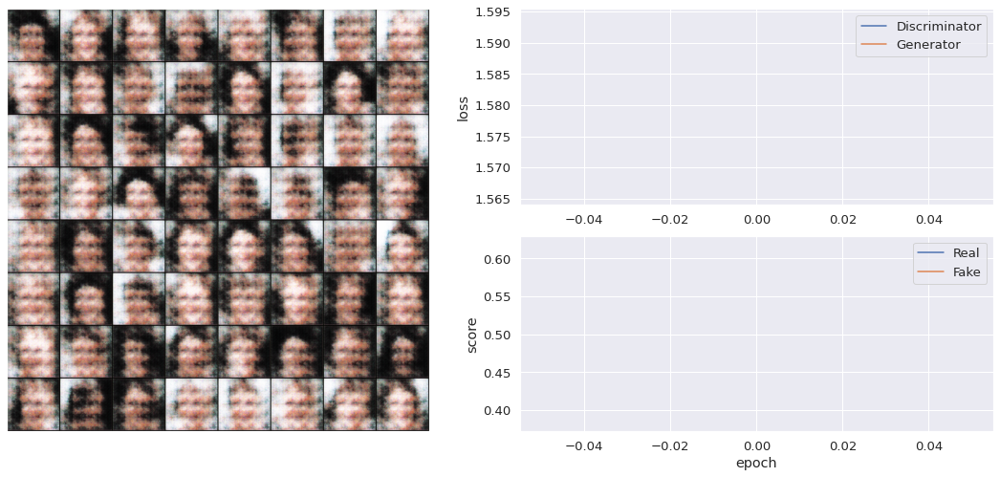

Epoch [1/30], loss_g: 1.5655, loss_d: 1.5940, real_score: 0.6177, fake_score: 0.3837


  0%|          | 0/469 [00:00<?, ?it/s]

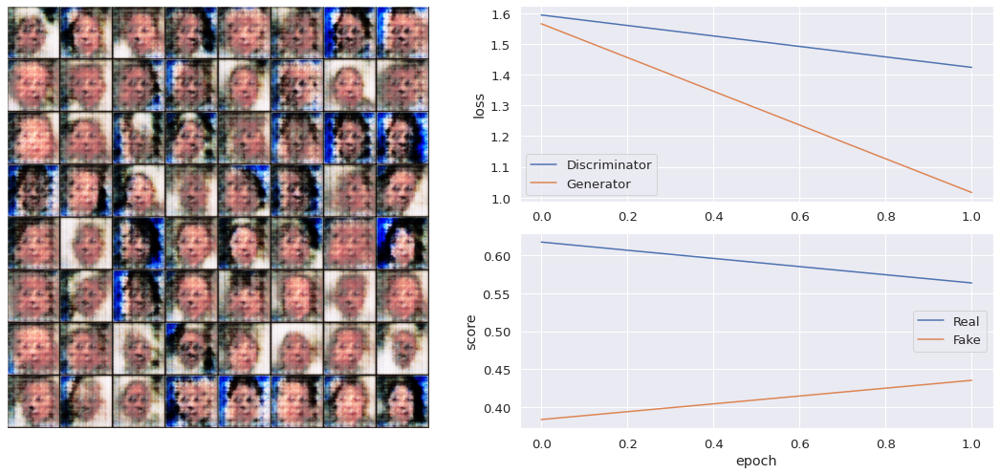

Epoch [2/30], loss_g: 1.0169, loss_d: 1.4236, real_score: 0.5638, fake_score: 0.4354


  0%|          | 0/469 [00:00<?, ?it/s]

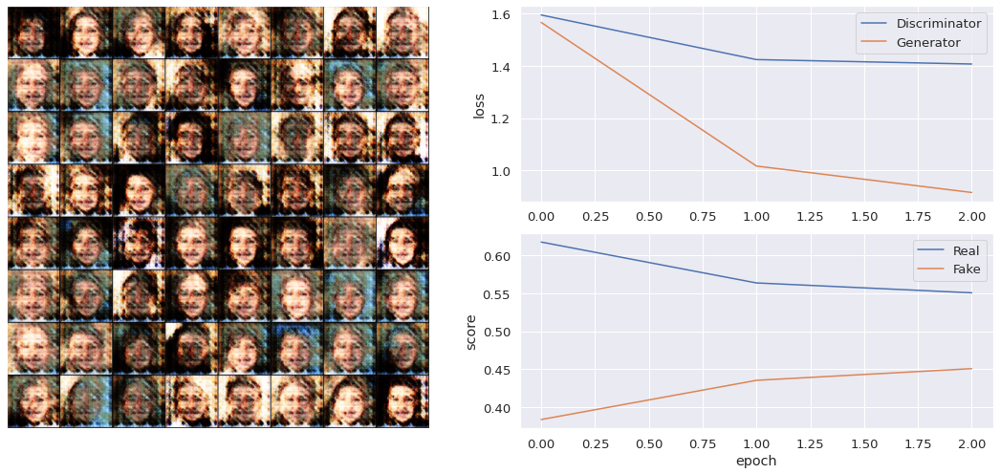

Epoch [3/30], loss_g: 0.9159, loss_d: 1.4067, real_score: 0.5508, fake_score: 0.4508


  0%|          | 0/469 [00:00<?, ?it/s]

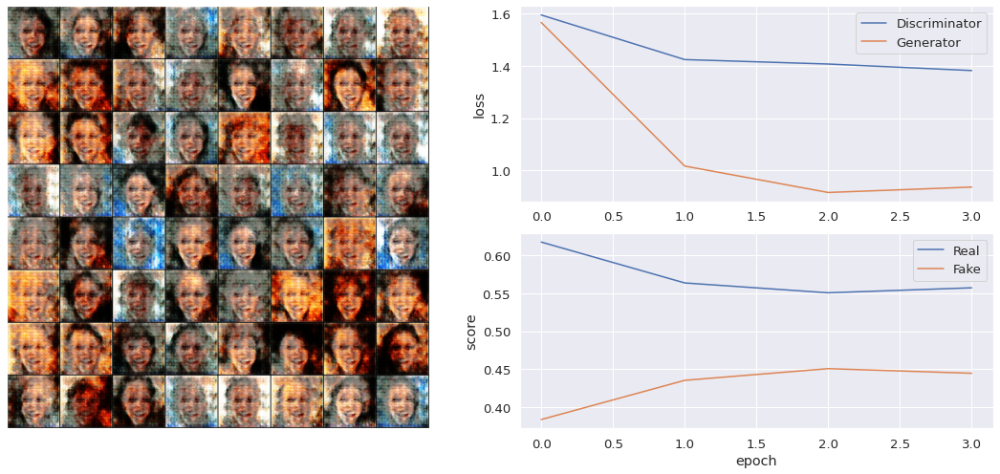

Epoch [4/30], loss_g: 0.9366, loss_d: 1.3817, real_score: 0.5574, fake_score: 0.4447


  0%|          | 0/469 [00:00<?, ?it/s]

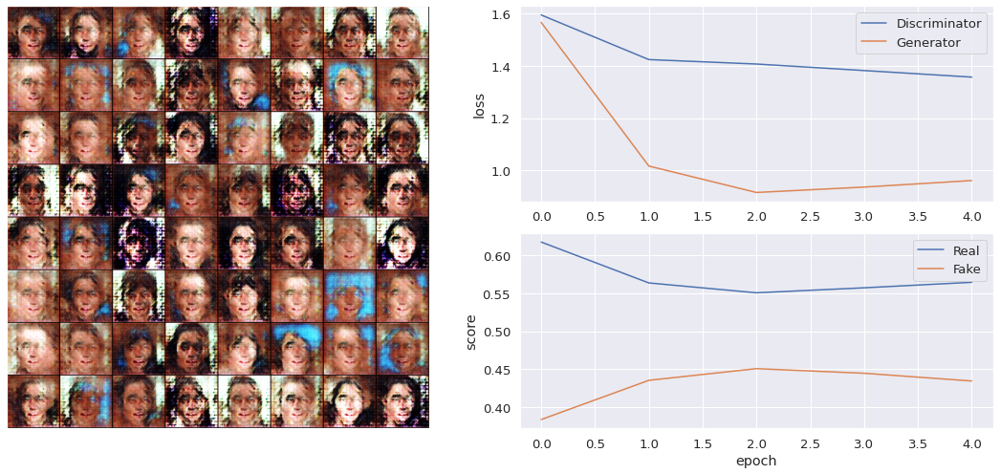

Epoch [5/30], loss_g: 0.9615, loss_d: 1.3567, real_score: 0.5646, fake_score: 0.4345


  0%|          | 0/469 [00:00<?, ?it/s]

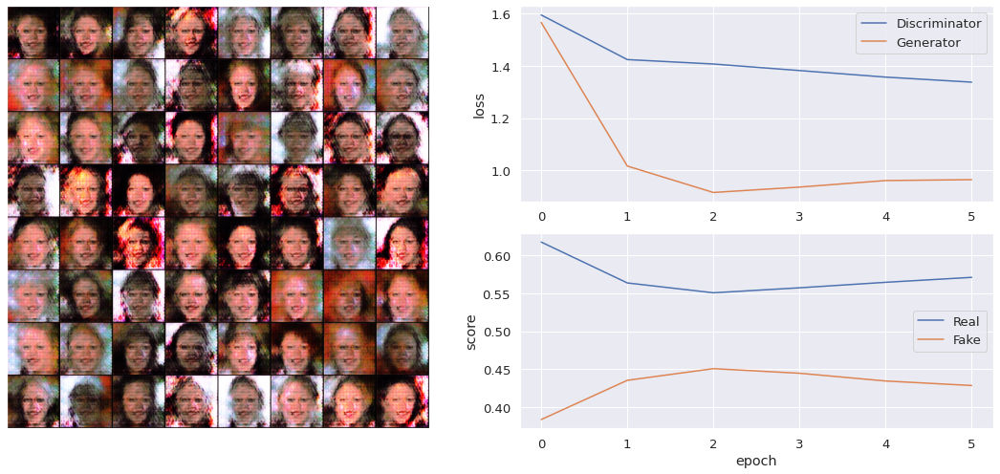

Epoch [6/30], loss_g: 0.9649, loss_d: 1.3373, real_score: 0.5711, fake_score: 0.4286


  0%|          | 0/469 [00:00<?, ?it/s]

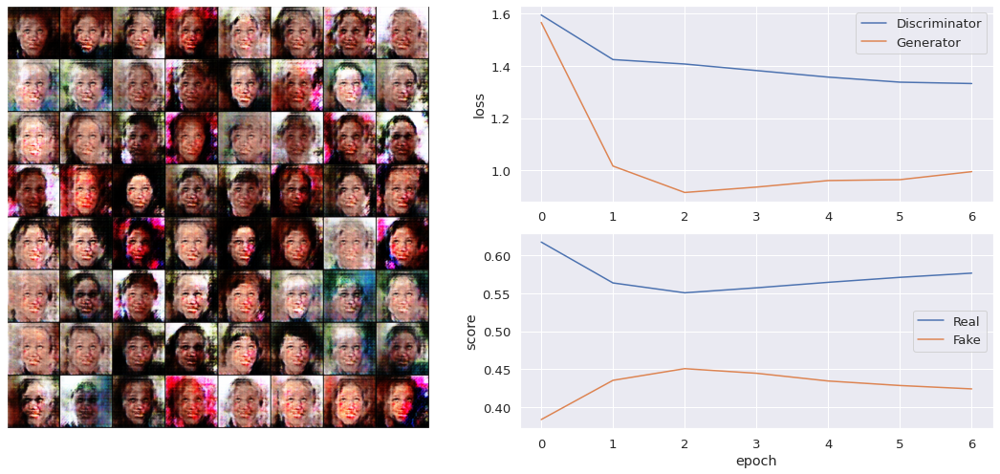

Epoch [7/30], loss_g: 0.9955, loss_d: 1.3321, real_score: 0.5767, fake_score: 0.4241


  0%|          | 0/469 [00:00<?, ?it/s]

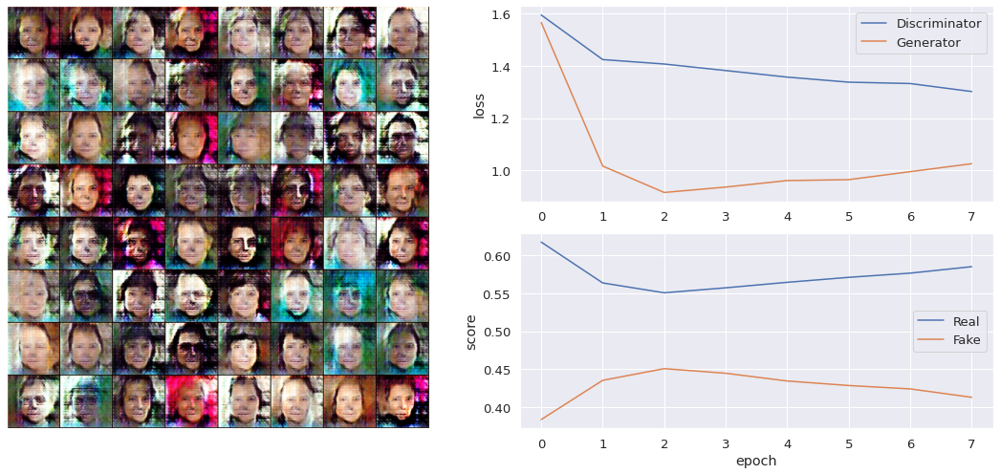

Epoch [8/30], loss_g: 1.0258, loss_d: 1.3016, real_score: 0.5852, fake_score: 0.4130


  0%|          | 0/469 [00:00<?, ?it/s]

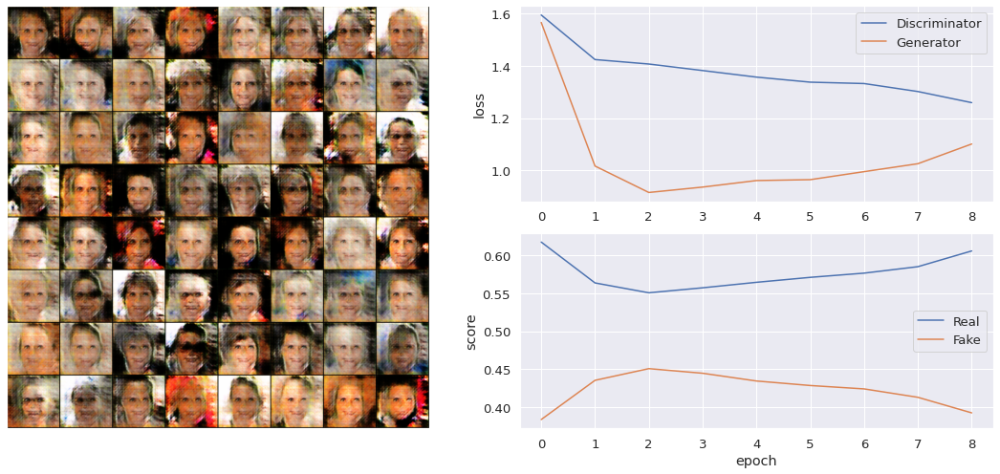

Epoch [9/30], loss_g: 1.1011, loss_d: 1.2591, real_score: 0.6060, fake_score: 0.3925


  0%|          | 0/469 [00:00<?, ?it/s]

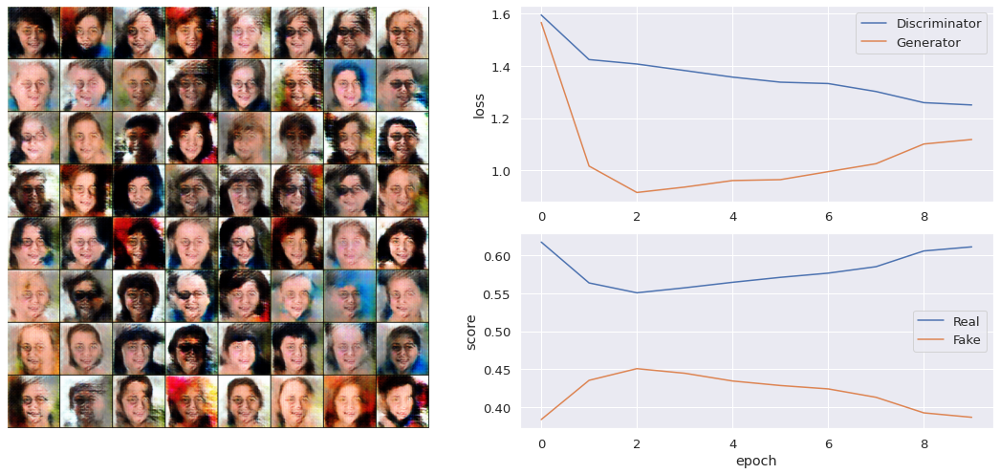

Epoch [10/30], loss_g: 1.1183, loss_d: 1.2503, real_score: 0.6113, fake_score: 0.3867


  0%|          | 0/469 [00:00<?, ?it/s]

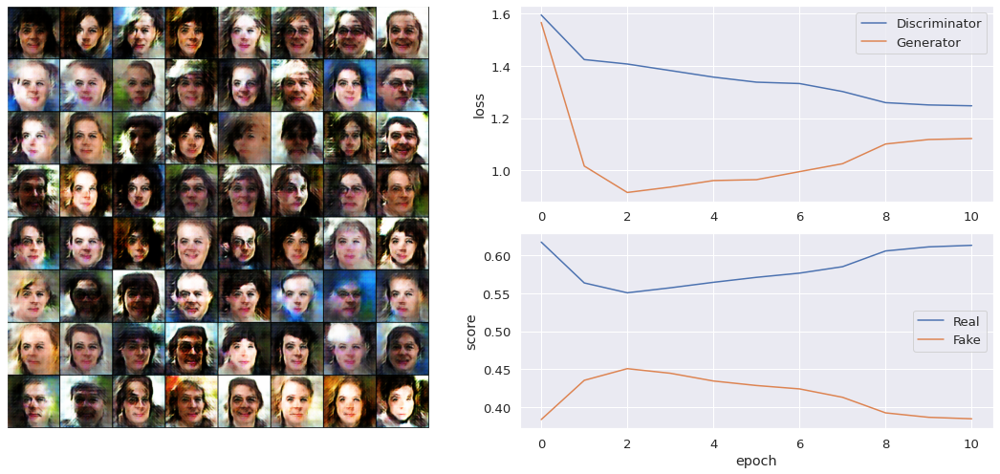

Epoch [11/30], loss_g: 1.1220, loss_d: 1.2470, real_score: 0.6134, fake_score: 0.3847


  0%|          | 0/469 [00:00<?, ?it/s]

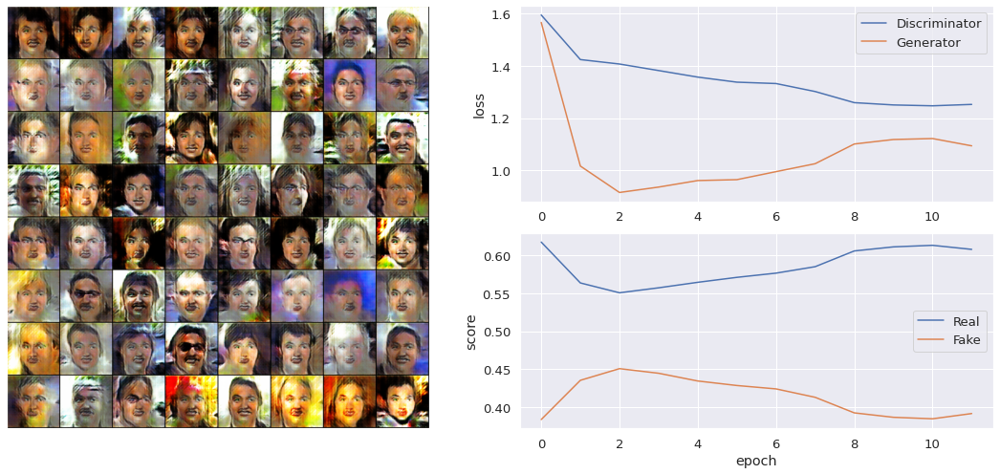

Epoch [12/30], loss_g: 1.0941, loss_d: 1.2524, real_score: 0.6080, fake_score: 0.3916


  0%|          | 0/469 [00:00<?, ?it/s]

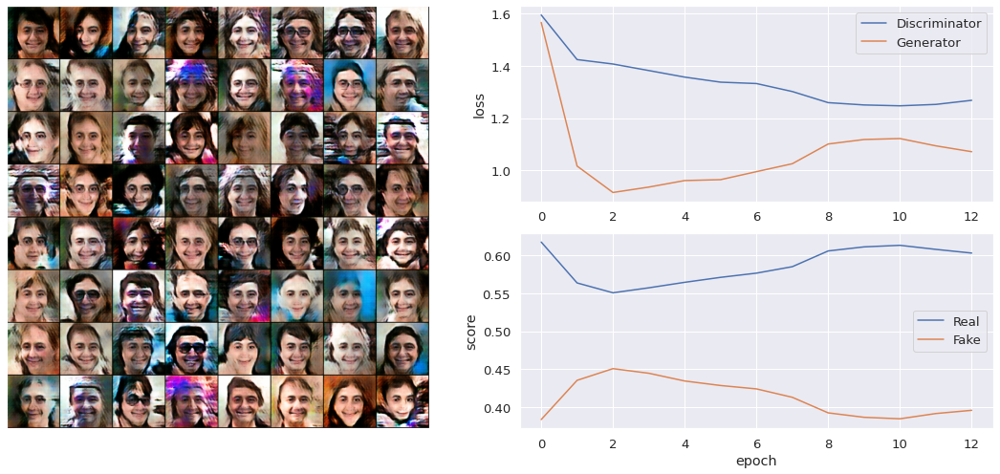

Epoch [13/30], loss_g: 1.0717, loss_d: 1.2680, real_score: 0.6032, fake_score: 0.3959


  0%|          | 0/469 [00:00<?, ?it/s]

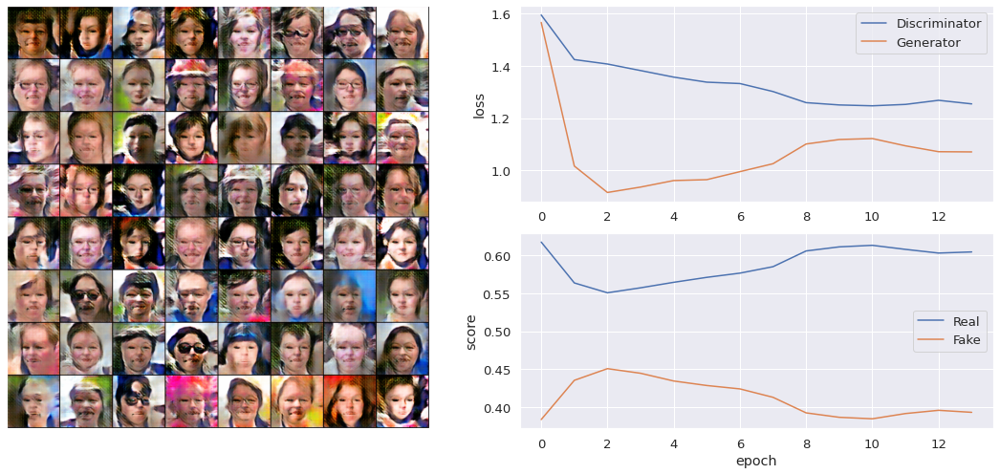

Epoch [14/30], loss_g: 1.0709, loss_d: 1.2544, real_score: 0.6047, fake_score: 0.3932


  0%|          | 0/469 [00:00<?, ?it/s]

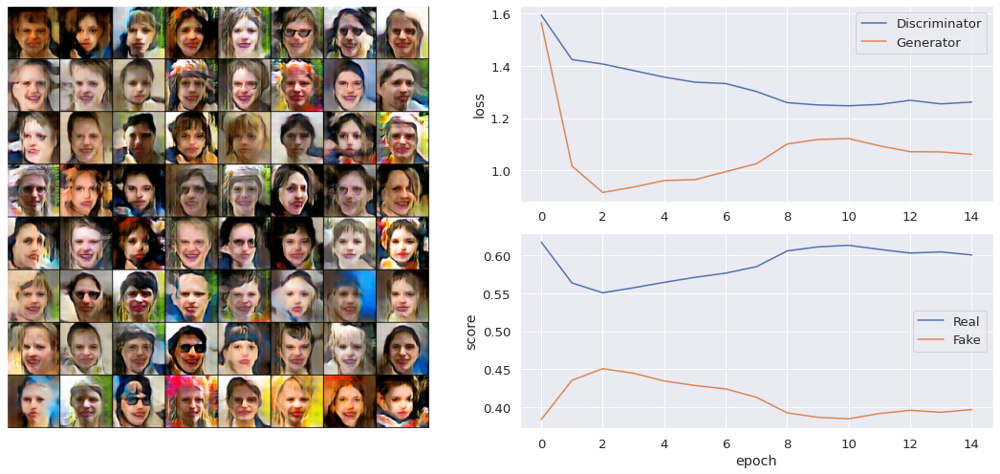

Epoch [15/30], loss_g: 1.0617, loss_d: 1.2614, real_score: 0.6007, fake_score: 0.3968


  0%|          | 0/469 [00:00<?, ?it/s]

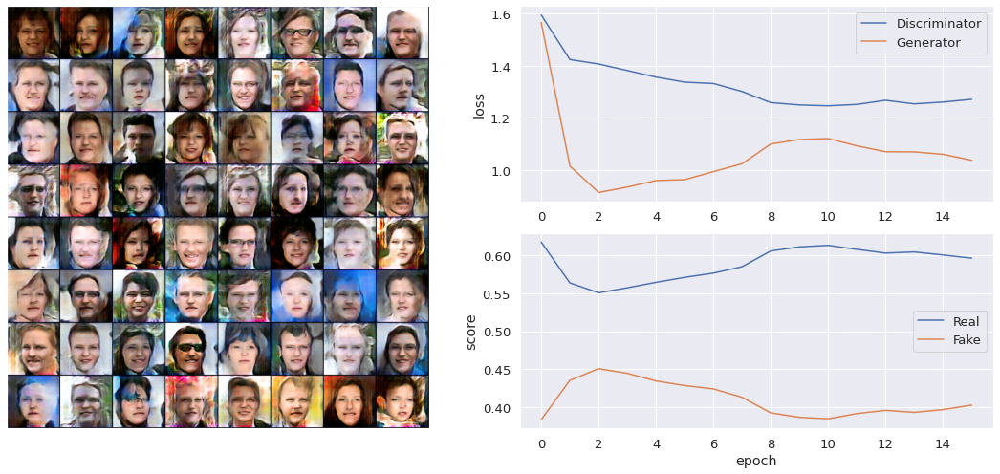

Epoch [16/30], loss_g: 1.0390, loss_d: 1.2718, real_score: 0.5964, fake_score: 0.4027


  0%|          | 0/469 [00:00<?, ?it/s]

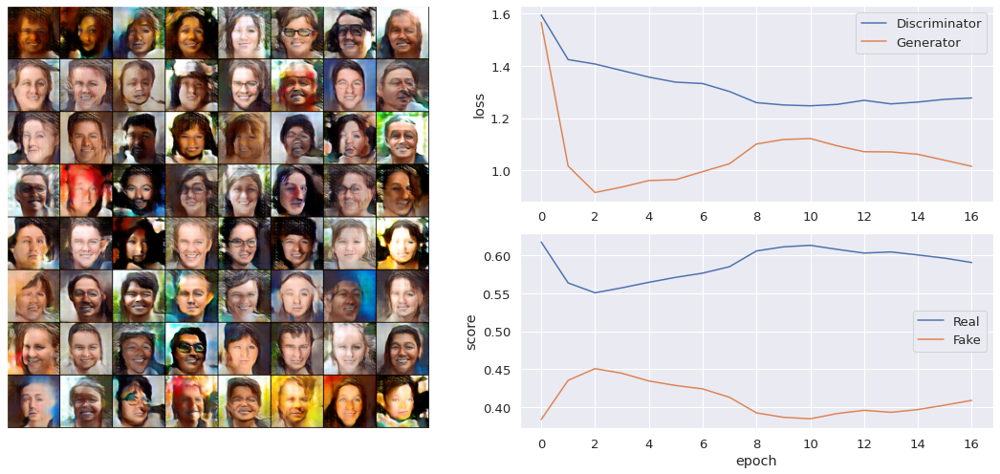

Epoch [17/30], loss_g: 1.0159, loss_d: 1.2769, real_score: 0.5907, fake_score: 0.4090


  0%|          | 0/469 [00:00<?, ?it/s]

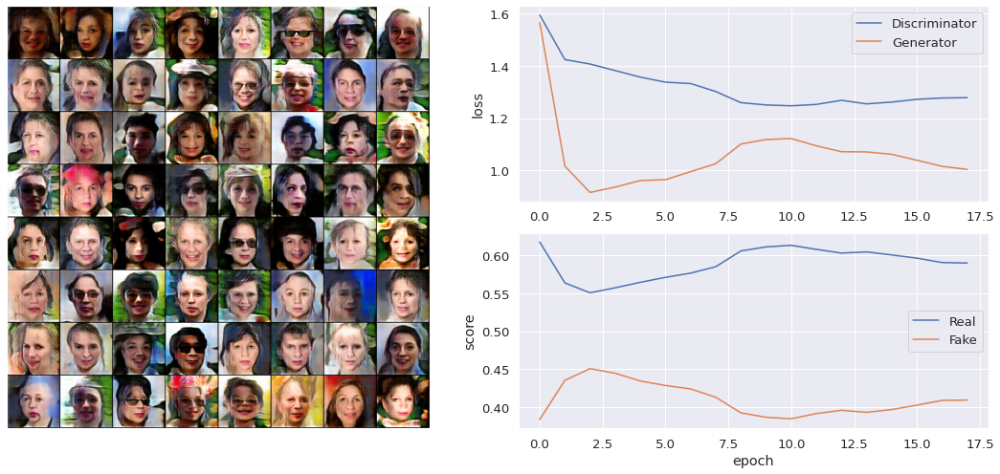

Epoch [18/30], loss_g: 1.0041, loss_d: 1.2782, real_score: 0.5900, fake_score: 0.4093


  0%|          | 0/469 [00:00<?, ?it/s]

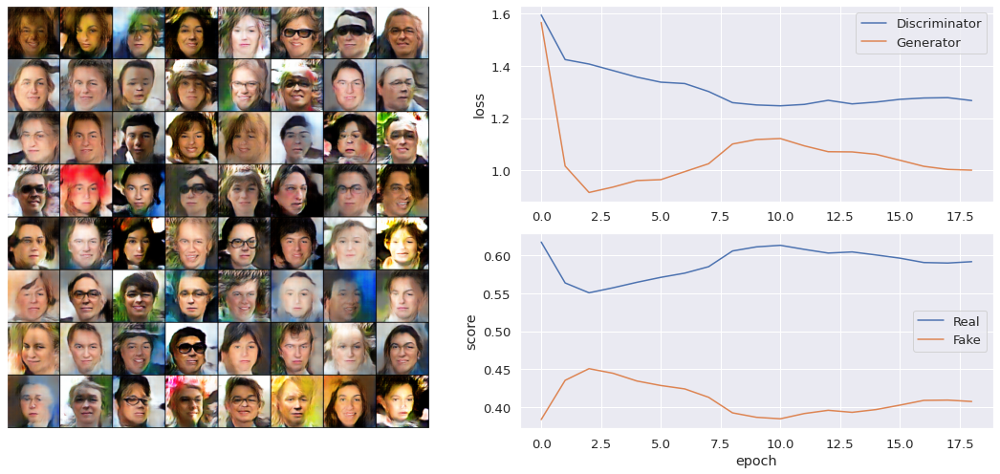

Epoch [19/30], loss_g: 1.0012, loss_d: 1.2671, real_score: 0.5918, fake_score: 0.4075


  0%|          | 0/469 [00:00<?, ?it/s]

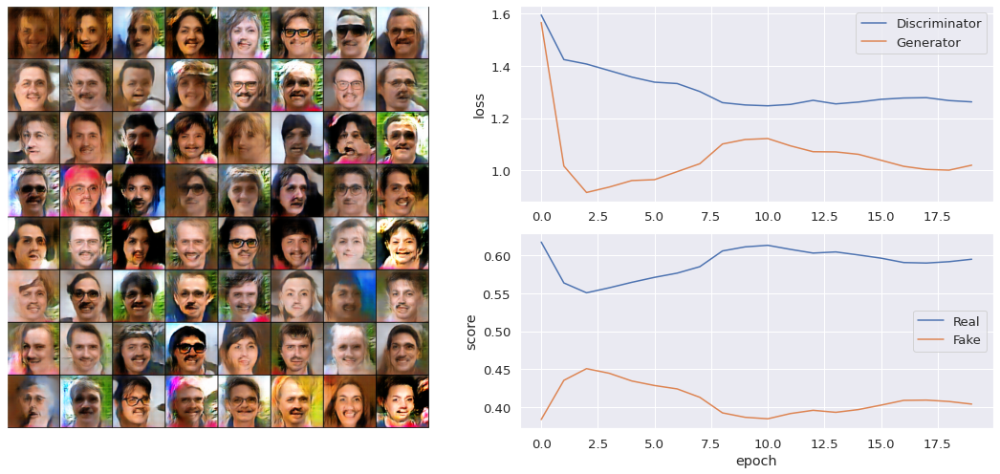

Epoch [20/30], loss_g: 1.0202, loss_d: 1.2621, real_score: 0.5950, fake_score: 0.4041


  0%|          | 0/469 [00:00<?, ?it/s]

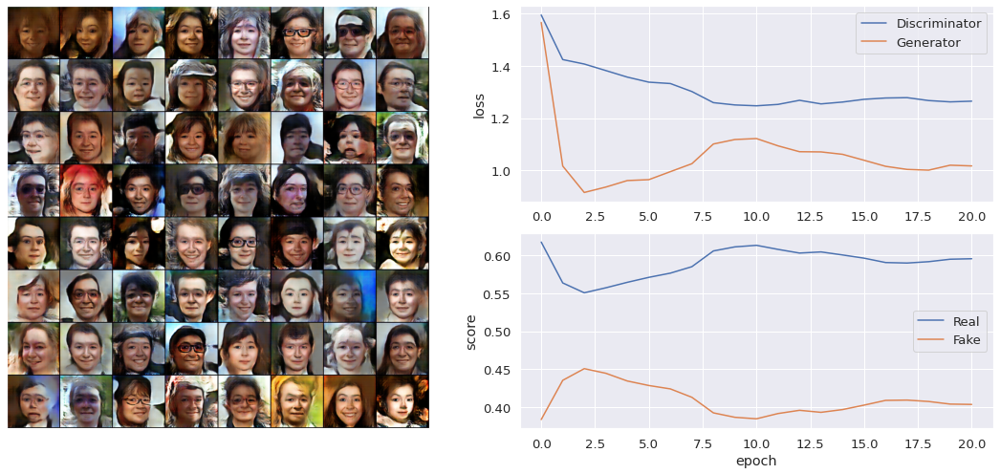

Epoch [21/30], loss_g: 1.0174, loss_d: 1.2647, real_score: 0.5957, fake_score: 0.4036


  0%|          | 0/469 [00:00<?, ?it/s]

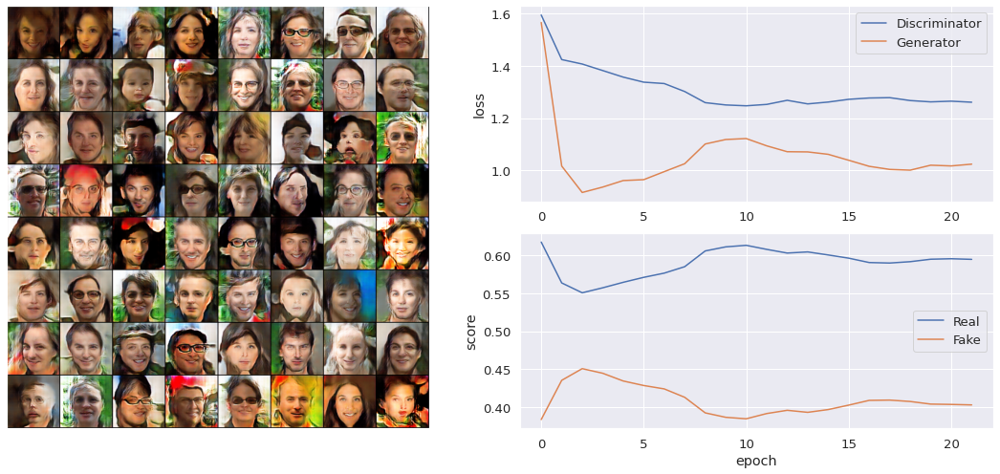

Epoch [22/30], loss_g: 1.0242, loss_d: 1.2607, real_score: 0.5949, fake_score: 0.4030


  0%|          | 0/469 [00:00<?, ?it/s]

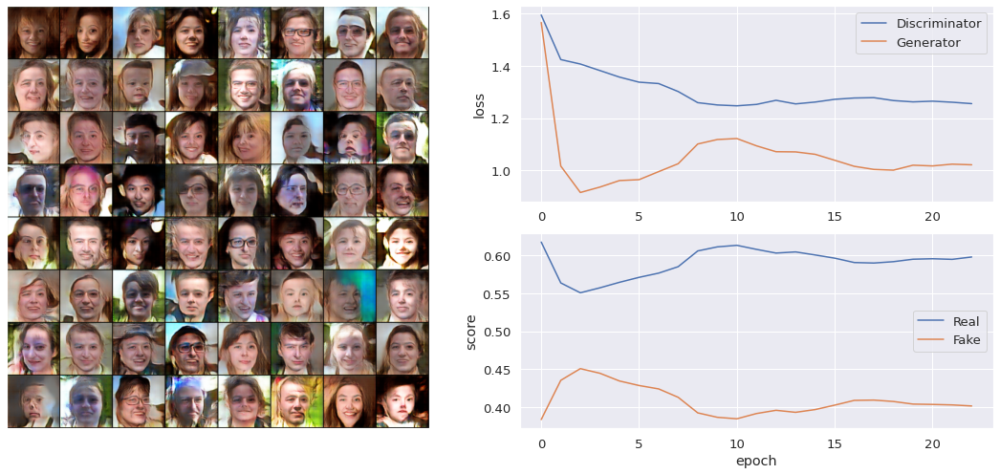

Epoch [23/30], loss_g: 1.0217, loss_d: 1.2553, real_score: 0.5980, fake_score: 0.4016


  0%|          | 0/469 [00:00<?, ?it/s]

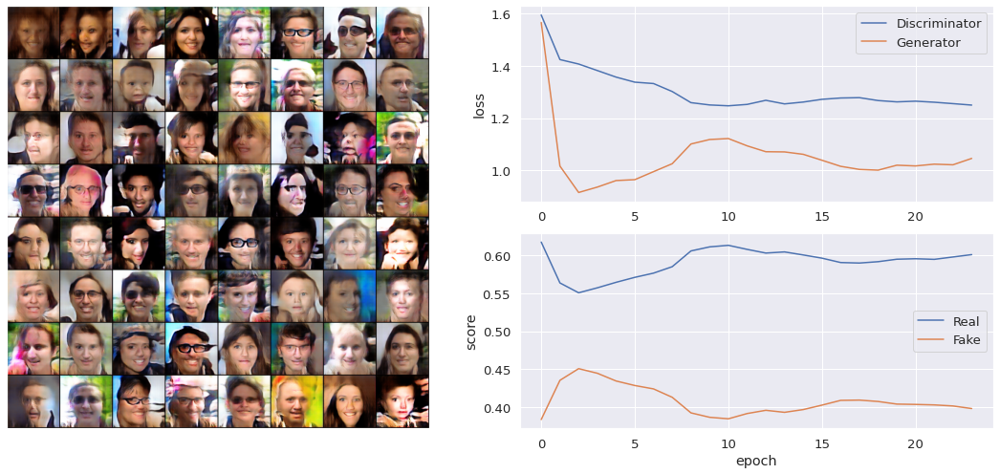

Epoch [24/30], loss_g: 1.0460, loss_d: 1.2498, real_score: 0.6011, fake_score: 0.3982


  0%|          | 0/469 [00:00<?, ?it/s]

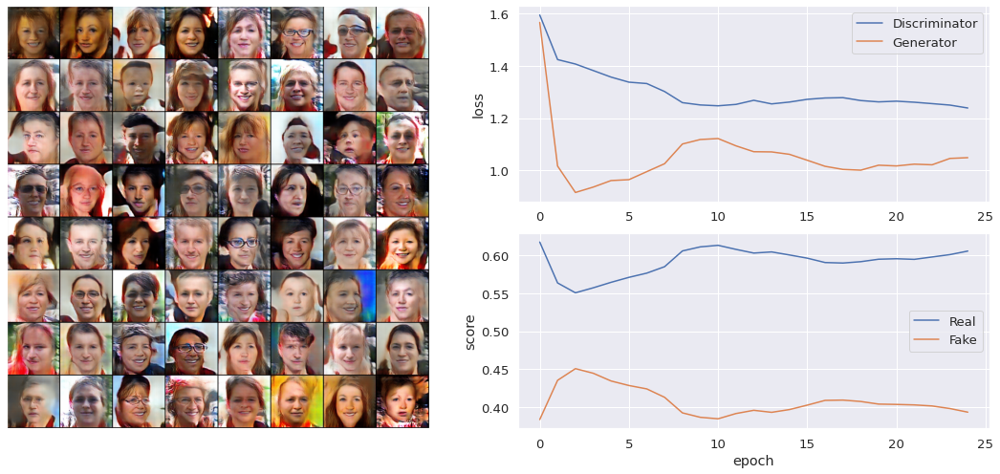

Epoch [25/30], loss_g: 1.0489, loss_d: 1.2387, real_score: 0.6058, fake_score: 0.3934


  0%|          | 0/469 [00:00<?, ?it/s]

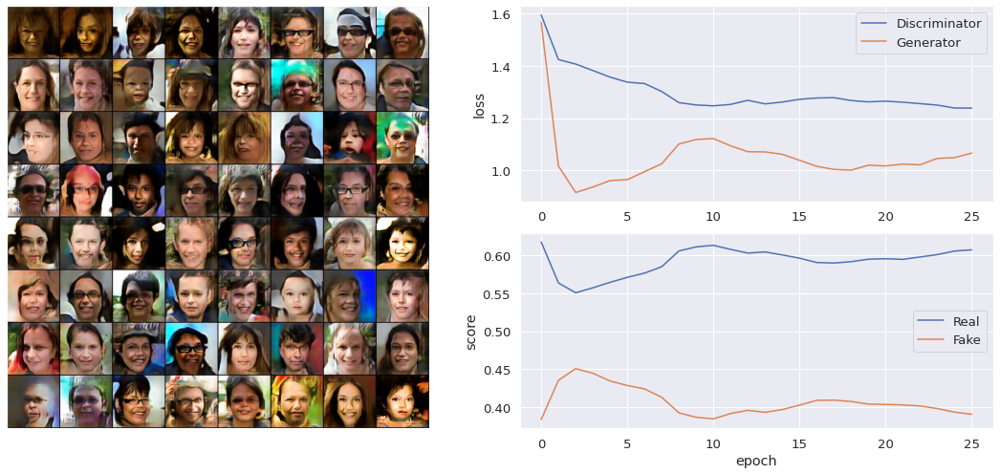

Epoch [26/30], loss_g: 1.0664, loss_d: 1.2381, real_score: 0.6075, fake_score: 0.3906


  0%|          | 0/469 [00:00<?, ?it/s]

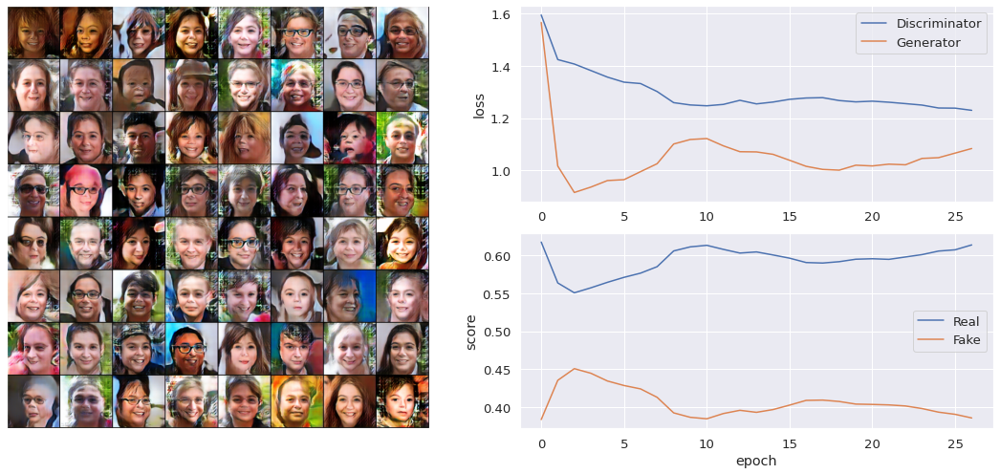

Epoch [27/30], loss_g: 1.0838, loss_d: 1.2298, real_score: 0.6139, fake_score: 0.3858


  0%|          | 0/469 [00:00<?, ?it/s]

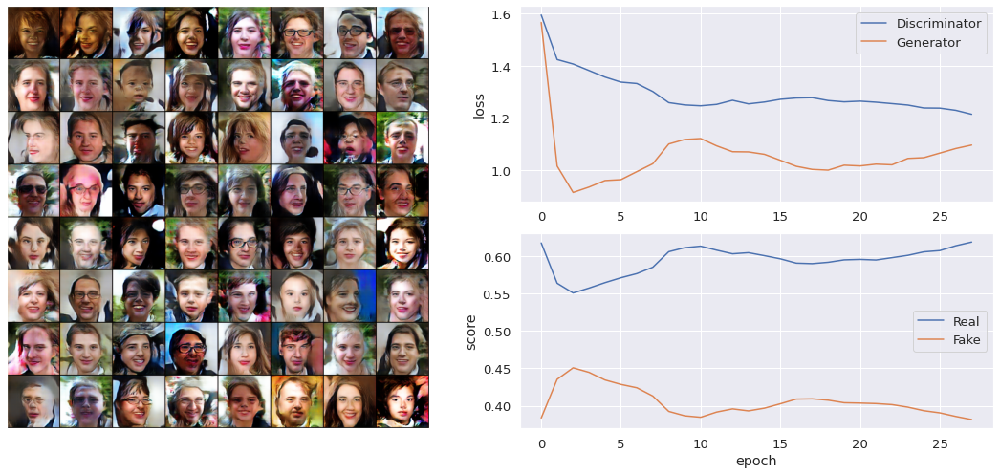

Epoch [28/30], loss_g: 1.0972, loss_d: 1.2147, real_score: 0.6189, fake_score: 0.3816


  0%|          | 0/469 [00:00<?, ?it/s]

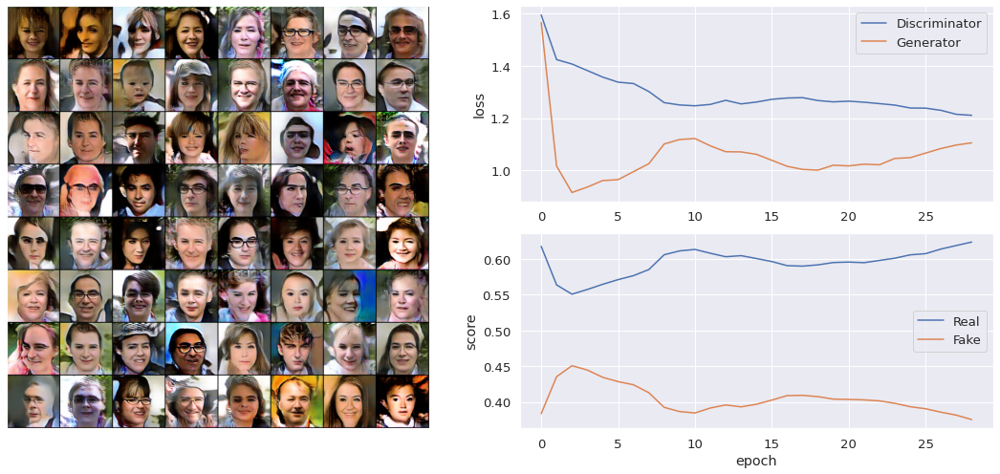

Epoch [29/30], loss_g: 1.1056, loss_d: 1.2107, real_score: 0.6237, fake_score: 0.3755


  0%|          | 0/469 [00:00<?, ?it/s]

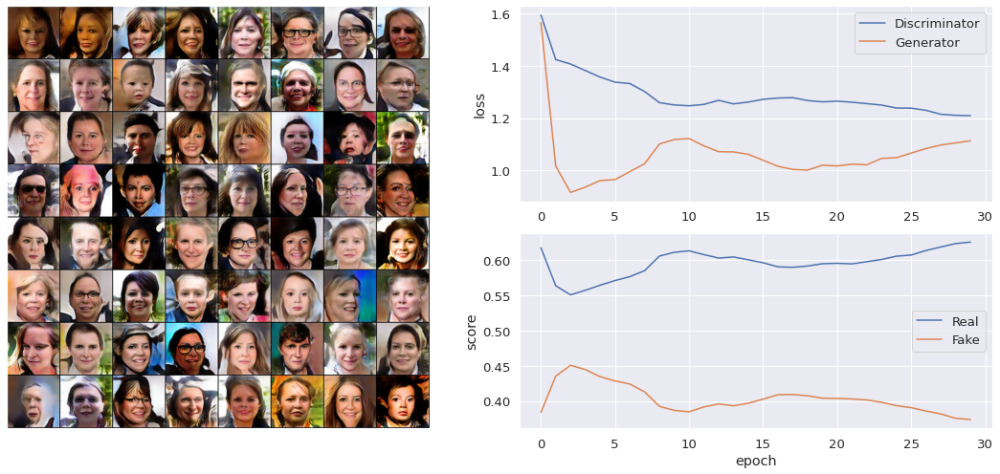

Epoch [30/30], loss_g: 1.1133, loss_d: 1.2093, real_score: 0.6259, fake_score: 0.3737


In [ ]:
losses_g, losses_d, real_scores, fake_scores = train_model(model, train_dl, criterion, 
                                                           optimizer, epochs=30,
                                                           model_name='dcGAN_gaus_soft_flip_drop_buff2_lr2')

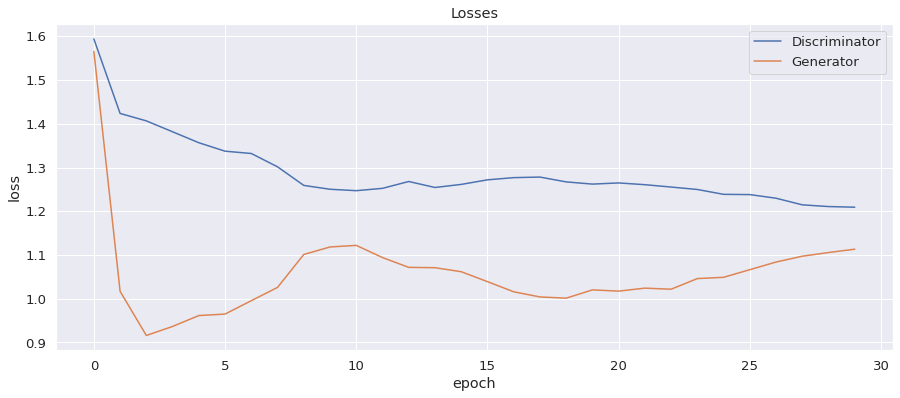

In [ ]:
plt.figure(figsize=(15, 6))
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

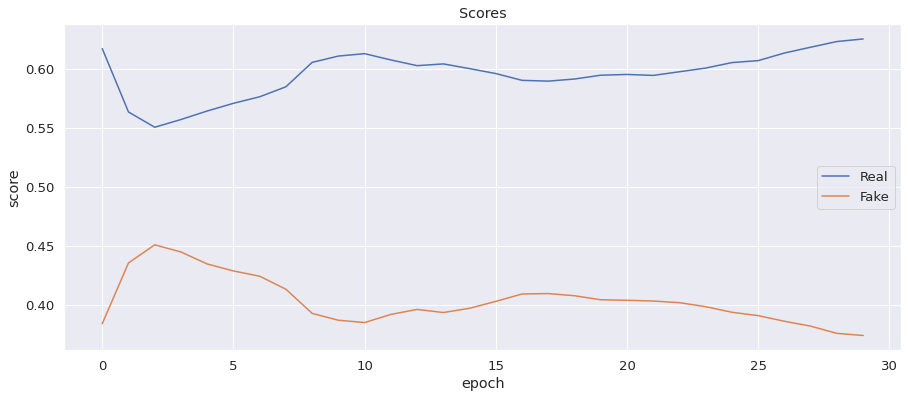

In [ ]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

Вообще, кривые обучения кака-то не совсем правильно отражают качество обучения модели, если судить по сгенерированным примерам. Да и лосс генератора изначально меньше лосса дискриминатора.

Например, наилучшее качество согласно скору должно быть на ~2-3 эпохе, а это явно не так.

Однако, качество модели явно ухудшается когда лоосы пересекаются (ну или когда скоры, наоборот, расходятся).

Скорее всего, я где-то намудрила с реализцией флипа/буфера.

## Часть 3. Генерация изображений (1 балл)

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [ ]:
n_images = 10

fixed_latent = torch.randn(n_images, LATENT_SIZE, 1, 1, device=DEVICE)
fake_images = model["generator"](fixed_latent)

In [ ]:
def show_images(generated):
    # TODO: show generated images
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(generated.detach().cpu()), nrow=n_images).permute(1, 2, 0));
    plt.show()

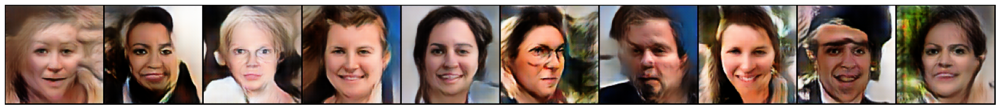

In [ ]:
show_images(fake_images)

Как вам качество получившихся изображений?

Очень средне (но это лучшее из того, что у меня в принципе получалось). Модель даже лица не особо генерирует, фон так тем более.

## Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)

### 4.1. Подсчет accuracy (4 балла)

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами. В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке. Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`) предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте. В этом вам поможет `sklearn.model_selection.LeaveOneOut`

https://github.com/yhlleo/GAN-Metrics

Будем ихвлекать карты спомощью Inception

In [ ]:
class InceptionV3(nn.Module):
    """Pretrained InceptionV3 network returning feature maps"""

    # Index of default block of inception to return,
    # corresponds to output of final average pooling
    DEFAULT_BLOCK_INDEX = 3

    # Maps feature dimensionality to their output blocks indices
    BLOCK_INDEX_BY_DIM = {
        64: 0,   # First max pooling features
        192: 1,  # Second max pooling featurs
        768: 2,  # Pre-aux classifier features
        2048: 3  # Final average pooling features
    }

    def __init__(self,
                 output_blocks=[DEFAULT_BLOCK_INDEX],
                 resize_input=True,
                 normalize_input=True,
                 requires_grad=False):
        """Build pretrained InceptionV3
        Parameters
        ----------
        output_blocks : list of int
            Indices of blocks to return features of. Possible values are:
                - 0: corresponds to output of first max pooling
                - 1: corresponds to output of second max pooling
                - 2: corresponds to output which is fed to aux classifier
                - 3: corresponds to output of final average pooling
        resize_input : bool
            If true, bilinearly resizes input to width and height 299 before
            feeding input to model. As the network without fully connected
            layers is fully convolutional, it should be able to handle inputs
            of arbitrary size, so resizing might not be strictly needed
        normalize_input : bool
            If true, scales the input from range (0, 1) to the range the
            pretrained Inception network expects, namely (-1, 1)
        requires_grad : bool
            If true, parameters of the model require gradient. Possibly useful
            for finetuning the network
        """
        super(InceptionV3, self).__init__()

        self.resize_input = resize_input
        self.normalize_input = normalize_input
        self.output_blocks = sorted(output_blocks)
        self.last_needed_block = max(output_blocks)

        assert self.last_needed_block <= 3, \
            'Last possible output block index is 3'

        self.blocks = nn.ModuleList()

        inception = models.inception_v3(pretrained=True)

        # Block 0: input to maxpool1
        block0 = [
            inception.Conv2d_1a_3x3,
            inception.Conv2d_2a_3x3,
            inception.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2)
        ]
        self.blocks.append(nn.Sequential(*block0))

        # Block 1: maxpool1 to maxpool2
        if self.last_needed_block >= 1:
            block1 = [
                inception.Conv2d_3b_1x1,
                inception.Conv2d_4a_3x3,
                nn.MaxPool2d(kernel_size=3, stride=2)
            ]
            self.blocks.append(nn.Sequential(*block1))

        # Block 2: maxpool2 to aux classifier
        if self.last_needed_block >= 2:
            block2 = [
                inception.Mixed_5b,
                inception.Mixed_5c,
                inception.Mixed_5d,
                inception.Mixed_6a,
                inception.Mixed_6b,
                inception.Mixed_6c,
                inception.Mixed_6d,
                inception.Mixed_6e,
            ]
            self.blocks.append(nn.Sequential(*block2))

        # Block 3: aux classifier to final avgpool
        if self.last_needed_block >= 3:
            block3 = [
                inception.Mixed_7a,
                inception.Mixed_7b,
                inception.Mixed_7c,
                nn.AdaptiveAvgPool2d(output_size=(1, 1))
            ]
            self.blocks.append(nn.Sequential(*block3))

        for param in self.parameters():
            param.requires_grad = requires_grad

    def forward(self, inp):
        """Get Inception feature maps
        Parameters
        ----------
        inp : torch.autograd.Variable
            Input tensor of shape Bx3xHxW. Values are expected to be in
            range (0, 1)
        Returns
        -------
        List of torch.autograd.Variable, corresponding to the selected output
        block, sorted ascending by index
        """
        outp = []
        x = inp

        if self.resize_input:
            x = F.interpolate(x,
                              size=(299, 299),
                              mode='bilinear',
                              align_corners=False)

        if self.normalize_input:
            x = 2 * x - 1  # Scale from range (0, 1) to range (-1, 1)
            #x = x.clone()
            #x[:, 0] = x[:, 0] * (0.229 / 0.5) + (0.485 - 0.5) / 0.5
            #x[:, 1] = x[:, 1] * (0.224 / 0.5) + (0.456 - 0.5) / 0.5
            #x[:, 2] = x[:, 2] * (0.225 / 0.5) + (0.406 - 0.5) / 0.5

        for idx, block in enumerate(self.blocks):
            x = block(x)
            if idx in self.output_blocks:
                outp.append(x)

            if idx == self.last_needed_block:
                break

        return outp

In [ ]:
def get_feature_maps(data_loader, dims=2048):
    block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[dims]
    model = InceptionV3()
    
    model.to(DEVICE)
    model.eval()

    scores = []

    for batch in tqdm(data_loader):
        # костыль
        if type(batch) == list:
            batch = batch[0]

        batch.to(DEVICE)
        with torch.no_grad():
            pred = model(batch)[0]

        scores.append(pred.view(-1, dims))

    activations = torch.cat(scores, dim=0).cpu()

    return activations

In [ ]:
N = 500 # количество примеров

In [ ]:
dcgan = model

In [ ]:
data_dl = get_dataloader(image_size=IMAGE_SIZE, batch_size=BATCH_SIZE, n_samples=N)

In [ ]:
real_feat_map = get_feature_maps(data_loader=data_dl)

In [ ]:
real_images = []

for i in data_dl:
    real_images.append(i)

real_images = torch.cat(real_images, dim=0)

In [ ]:
latent_noise = torch.randn(N, LATENT_SIZE, 1, 1, device=DEVICE)
dcgan["generator"].eval()
with torch.no_grad():
    fake_images = dcgan["generator"](latent_noise).detach()

fake_ds = torch.utils.data.TensorDataset(fake_images.detach())
fake_dl = DataLoader(fake_ds, batch_size=BATCH_SIZE)

In [ ]:
fake_feat_map = get_feature_maps(data_loader=fake_dl)

In [ ]:
true_fake_maps = torch.cat((fake_feat_map, real_feat_map), dim=0)
labels = torch.cat((torch.zeros((fake_images.shape[0])), 
                    torch.ones((real_images.shape[0]))), dim=0)
assert true_fake_maps.shape[0] == labels.shape[0], 'dims do not match'

In [ ]:
%%time
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import LeaveOneOut, cross_val_score

cv = LeaveOneOut()

knn = KNeighborsClassifier(n_neighbors=1)

scores = cross_val_score(knn, true_fake_maps, labels, scoring='accuracy',
                         cv=cv, n_jobs=-1, verbose=10)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1833s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1130s.) Setting batch_size=4.
[Parallel(n_jobs=-1)]: Done  32 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1777s.) Setting batch_size=8.
[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done 160 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 248 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 336 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 440 tasks      | elapsed:  

CPU times: user 2.64 s, sys: 868 ms, total: 3.51 s
Wall time: 15.4 s


[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:   14.9s finished


In [ ]:
print(f'loo 1-NN: {np.mean(scores)}')

loo 1-NN: 0.852


Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?

Идеальный loo 1nn accuracy должен быть 0.5.

Задача GAN'а выучить распределение данных. Если это получилось, то реальные и сгенерированные данные хорош перемешаны между собой. Значит, для каждого элемента ближайший элемент может быть как сгенерированным, так и реальным с равной вероятностью. То есть, kNN будет выдавать, по сути, рандом.

У обученного GAN'а результат не очень хороший, что видно и по сгенерированным примерам выше.

### 4.2. Визуализация распределений (2 балла)

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений. Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике разным цветом точки, соответствующие реальным и сгенерированным изображенияи

In [ ]:
from sklearn.manifold import TSNE

embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(true_fake_maps)

In [ ]:
import pandas as pd

gan_visual = pd.DataFrame(data=embedded, columns=['x', 'y'])
gan_visual['label'] = labels
print(gan_visual.shape)
gan_visual.head()

(1000, 3)


,x,y,label
0,6.791180,-21.219635,0.0
1,10.925280,-2.517319,0.0
2,-3.241821,-15.799995,0.0
3,19.908384,-7.510024,0.0
4,0.828304,-18.552065,0.0


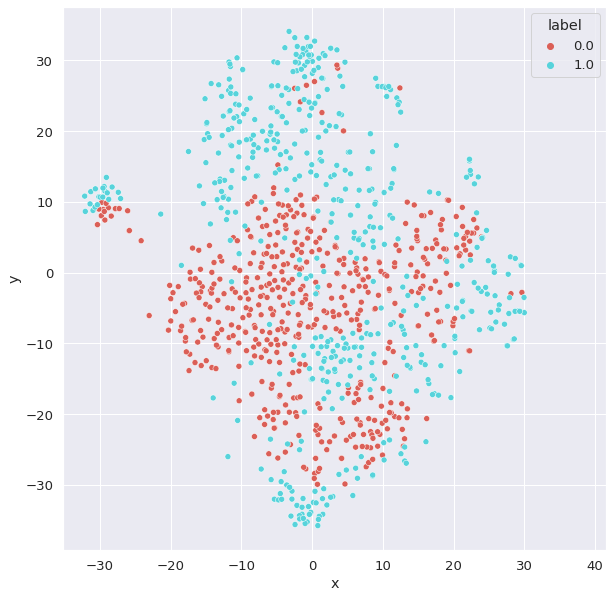

In [ ]:
import seaborn as sns

plt.figure(figsize=(10,10))
sns.scatterplot(
    x = 'x', 
    y = 'y',
    hue = 'label',
    palette = sns.color_palette('hls', 2),
    data = gan_visual,
    legend = 'full',
    );
plt.axis('square');

Прокомментируйте получившийся результат:

По распределению видно, что реальные изоражения от сгенерированных хорошо отделимы, в основном они не перемешаны друг с другом, хотя местами и пересекаются. Это вполне согласуется с loo 1nn метрикой выше, как мне кажется.